
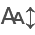

In [7]:
import pandas as pd 
from itables import init_notebook_mode
init_notebook_mode(all_interactive=True)
import cv2
import matplotlib.pyplot as plt
import os
import shutil
from PIL import Image, ImageDraw

In [30]:
df_pred = pd.read_csv('pred.csv')
df_pred

image_name  xmin  ymin  xmax  ymax  class_id  confidence  \
0    M3-BH3299-1.jpg   359   355   433   388         1    0.769112   
1    M3-BH3299-1.jpg   362   403   489   436         1    0.506460   
2    M3-BH3299-1.jpg   193   403   347   438         1    0.553025   
3    M3-BH3299-1.jpg   255   355   340   388         1    0.632444   
4    M3-BH3299-1.jpg   432   300   451   336         0    0.635386   
..               ...   ...   ...   ...   ...       ...         ...   
786  M3-BH3301-9.jpg   603   256   631   280         0    0.688404   
787  M3-BH3301-9.jpg   558   301   626   332         1    0.694067   
788  M3-BH3301-9.jpg   152   304   208   333         1    0.744558   
789  M3-BH3301-9.jpg    57   303   126   333         1    0.807544   
790  M3-BH3301-9.jpg   433   343   453   374         0    0.664645   

     label_name  center_x  center_y  range_id  
0    +10cm rock     396.0     371.5         3  
1    +10cm rock     425.5     419.5         4  
2    +10cm rock     270.0     420.5         4  
3    +10cm rock     297.5     371.5         3  
4          wood     441.5     318.0         2  
..          ...       ...       ...       ...  
786        wood     617.0     268.0         1  
787  +10cm rock     592.0     316.5         2  
788  +10cm rock     180.0     318.5         2  
789  +10cm rock      91.5     318.0         2  
790        wood     443.0     358.5         3  

[791 rows x 11 columns]

In [31]:
def assign_range_id(center_y):
    if 0 < center_y <= 235:
        return 0
    elif 235 < center_y <= 280:
        return 1
    elif 280 < center_y <= 330:
        return 2
    elif 330 < center_y <= 380:
        return 3
    elif 380 < center_y <= 450:
        return 4

df_pred["range_id"] = df_pred["center_y"].apply(assign_range_id)

sorted_df = df_pred.sort_values(by=["image_name", "range_id", "center_x"]).reset_index(drop=True)

In [32]:
sorted_df

image_name  xmin  ymin  xmax  ymax  class_id  confidence  \
0    M3-BH3299-1.jpg    20   305   166   339         1    0.752624   
1    M3-BH3299-1.jpg   432   300   451   336         0    0.635386   
2    M3-BH3299-1.jpg    25   352   144   387         1    0.491585   
3    M3-BH3299-1.jpg   255   355   340   388         1    0.632444   
4    M3-BH3299-1.jpg   359   355   433   388         1    0.769112   
..               ...   ...   ...   ...   ...       ...         ...   
786  M3-BH3301-9.jpg    75   346   137   376         1    0.619403   
787  M3-BH3301-9.jpg   433   343   453   374         0    0.664645   
788  M3-BH3301-9.jpg   416   390   488   422         1    0.334033   
789  M3-BH3301-9.jpg   420   389   589   421         1    0.403910   
790  M3-BH3301-9.jpg   493   390   584   419         1    0.564512   

     label_name  center_x  center_y  range_id  
0    +10cm rock      93.0     322.0         2  
1          wood     441.5     318.0         2  
2    +10cm rock      84.5     369.5         3  
3    +10cm rock     297.5     371.5         3  
4    +10cm rock     396.0     371.5         3  
..          ...       ...       ...       ...  
786  +10cm rock     106.0     361.0         3  
787        wood     443.0     358.5         3  
788  +10cm rock     452.0     406.0         4  
789  +10cm rock     504.5     405.0         4  
790  +10cm rock     538.5     404.5         4  

[791 rows x 11 columns]

In [33]:
def merge_bounding_boxes(group_df):
    merged_boxes = []
    current_box = group_df.iloc[0]
    
    for idx, row in group_df.iterrows():
        if (row['xmin'] <= current_box['xmax'] and row['xmax'] >= current_box['xmin'] and
            row['ymin'] <= current_box['ymax'] and row['ymax'] >= current_box['ymin'] and
            row['label_name'] == current_box['label_name']):
            
            current_box['xmin'] = min(current_box['xmin'], row['xmin'])
            current_box['ymin'] = min(current_box['ymin'], row['ymin'])
            current_box['xmax'] = max(current_box['xmax'], row['xmax'])
            current_box['ymax'] = max(current_box['ymax'], row['ymax'])
        else:
            merged_boxes.append(current_box)
            current_box = row
            
    merged_boxes.append(current_box)
    
    merged_df = pd.DataFrame(merged_boxes)
    return merged_df

result_df = sorted_df.groupby(['image_name', 'range_id'], group_keys=False).apply(merge_bounding_boxes)
result_df = result_df.reset_index(drop=True)
result_df

C:\Users\Mahbod\AppData\Local\Temp\ipykernel_30960\4157794966.py:23: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  result_df = sorted_df.groupby(['image_name', 'range_id'], group_keys=False).apply(merge_bounding_boxes)


image_name  xmin  ymin  xmax  ymax  class_id  confidence  \
0    M3-BH3299-1.jpg    20   305   166   339         1    0.752624   
1    M3-BH3299-1.jpg   432   300   451   336         0    0.635386   
2    M3-BH3299-1.jpg    25   352   144   387         1    0.491585   
3    M3-BH3299-1.jpg   255   355   340   388         1    0.632444   
4    M3-BH3299-1.jpg   359   355   433   388         1    0.769112   
..               ...   ...   ...   ...   ...       ...         ...   
653  M3-BH3301-9.jpg   152   304   208   333         1    0.744558   
654  M3-BH3301-9.jpg   558   301   626   332         1    0.694067   
655  M3-BH3301-9.jpg    75   346   137   376         1    0.619403   
656  M3-BH3301-9.jpg   433   343   453   374         0    0.664645   
657  M3-BH3301-9.jpg   416   389   589   422         1    0.334033   

     label_name  center_x  center_y  range_id  
0    +10cm rock      93.0     322.0         2  
1          wood     441.5     318.0         2  
2    +10cm rock      84.5     369.5         3  
3    +10cm rock     297.5     371.5         3  
4    +10cm rock     396.0     371.5         3  
..          ...       ...       ...       ...  
653  +10cm rock     180.0     318.5         2  
654  +10cm rock     592.0     316.5         2  
655  +10cm rock     106.0     361.0         3  
656        wood     443.0     358.5         3  
657  +10cm rock     452.0     406.0         4  

[658 rows x 11 columns]

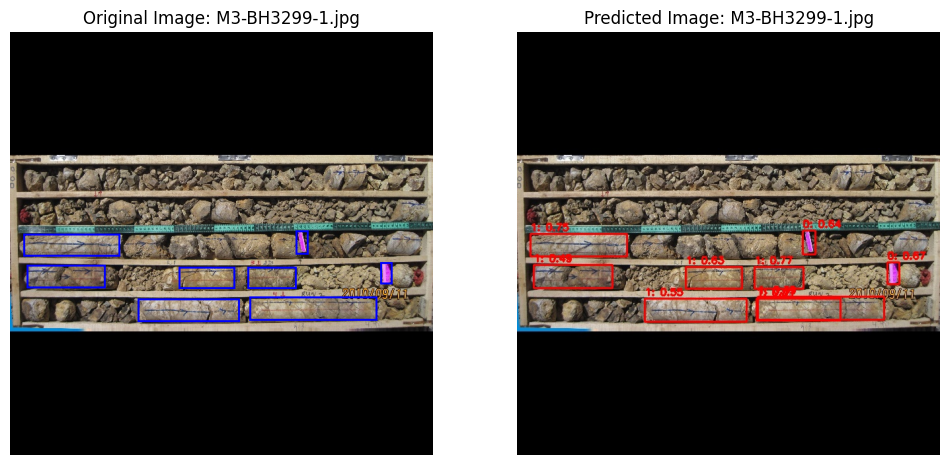

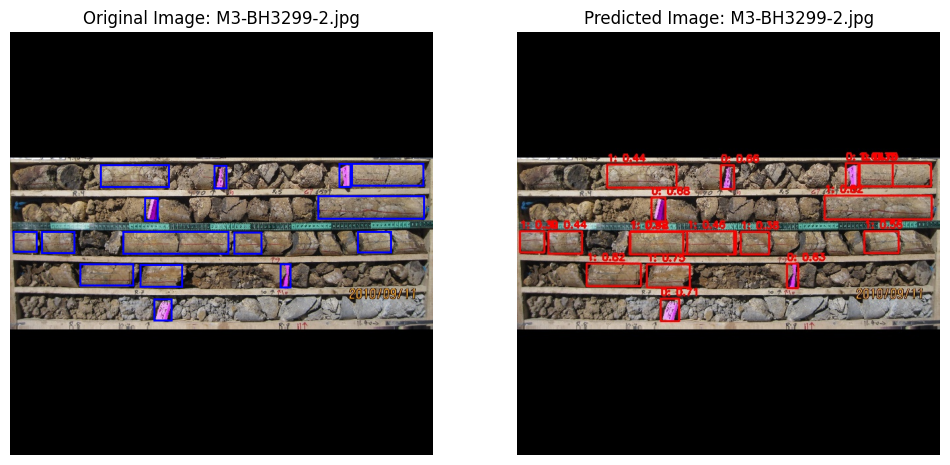

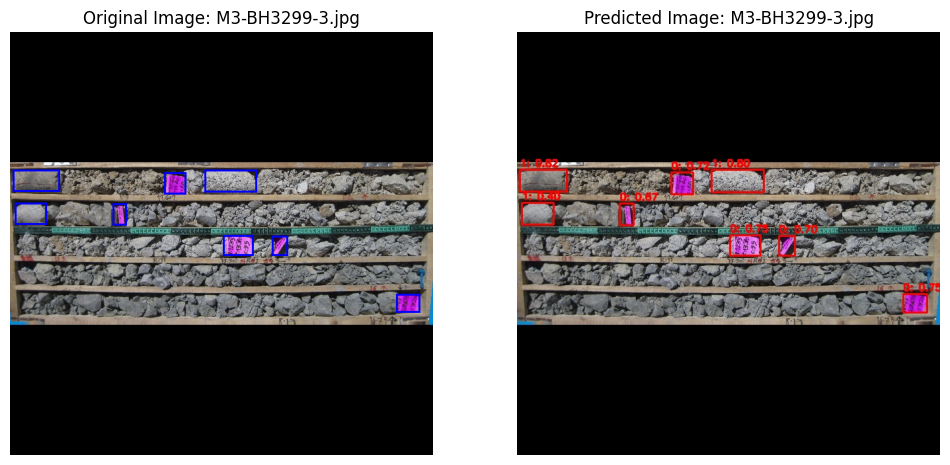

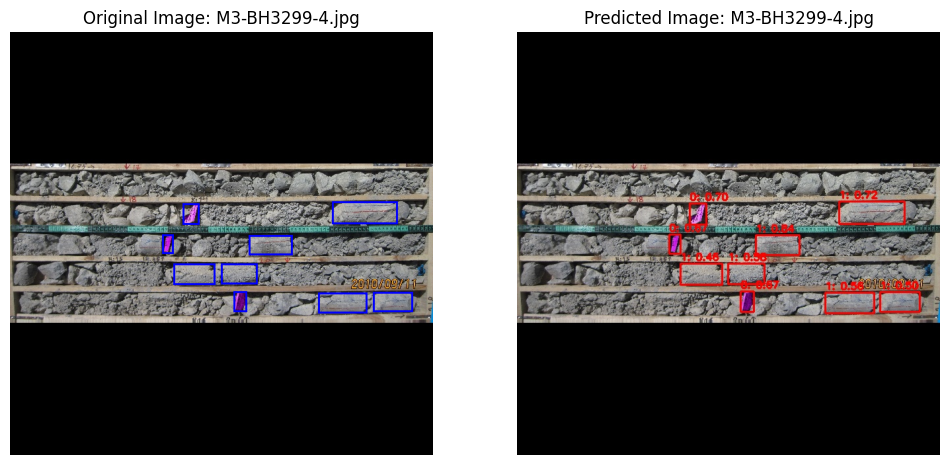

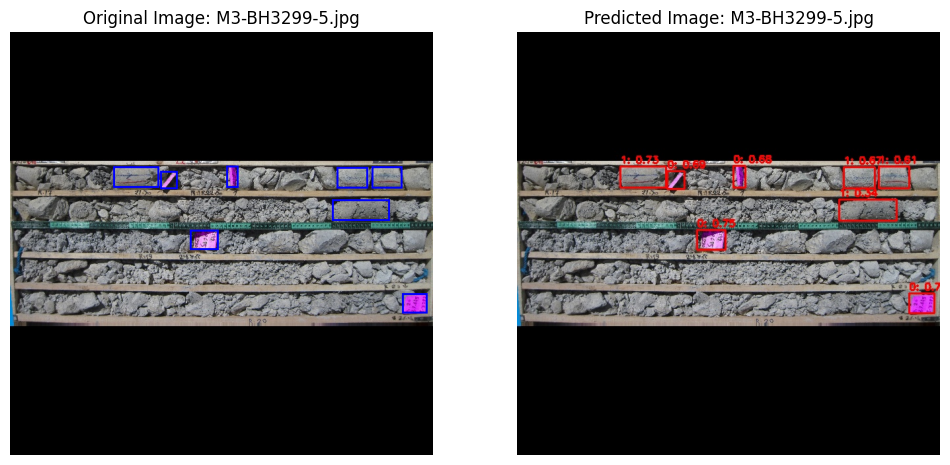

...

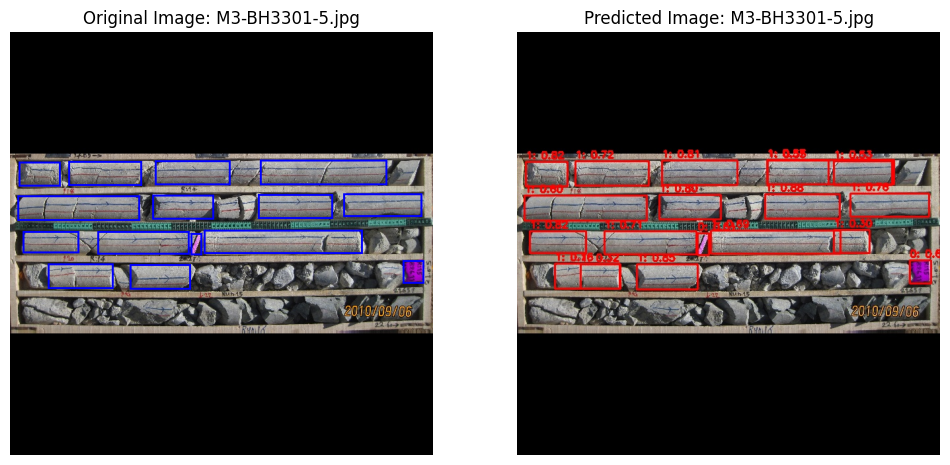

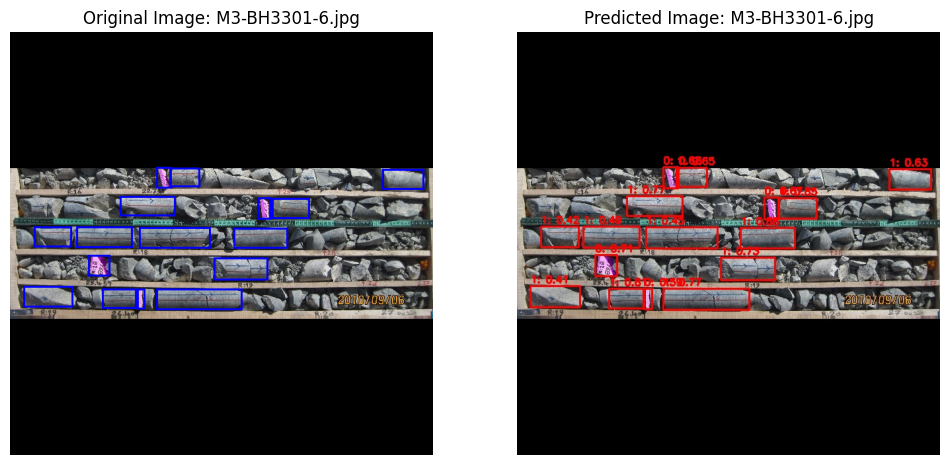

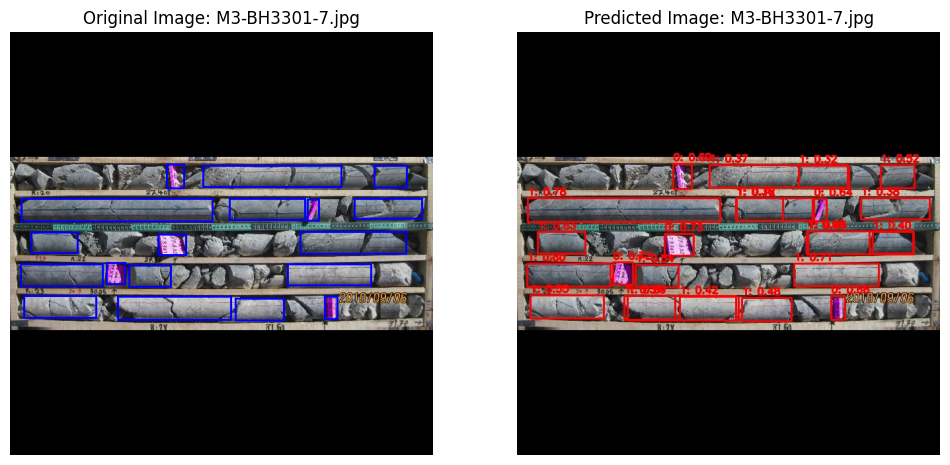

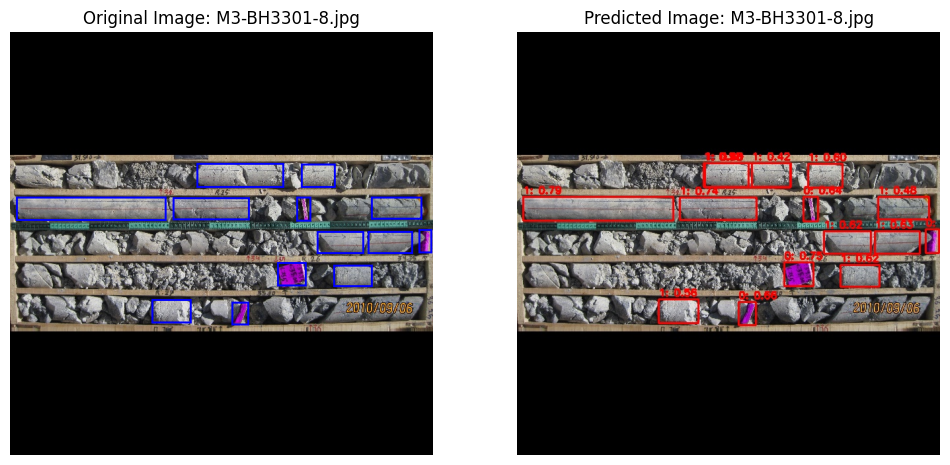

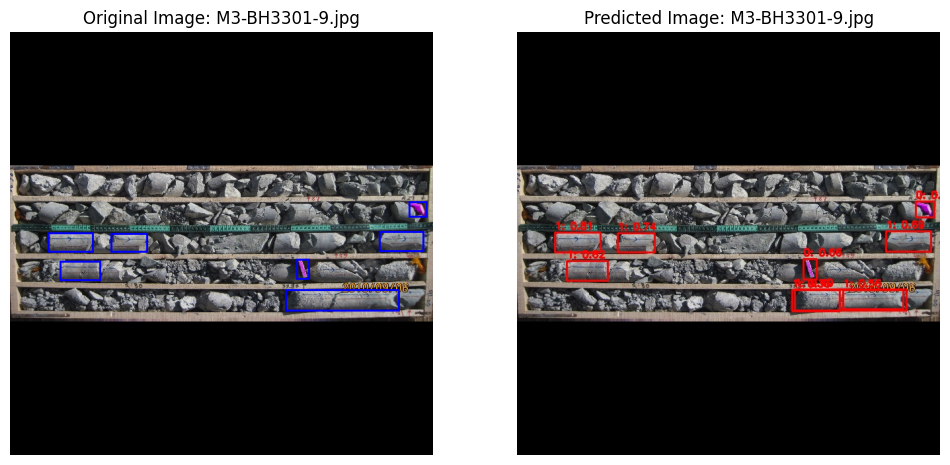

In [34]:
test_folder = r"F:\deep_learning\mine_project\test-rqd"
predicted_folder = r"F:\deep_learning\mine_project\predicted"

def draw_bounding_boxes(image_path, bounding_boxes, box_color="blue"):
    image = Image.open(image_path)
    draw = ImageDraw.Draw(image)
    for _, row in bounding_boxes.iterrows():
        x_min, y_min, x_max, y_max = row['xmin'], row['ymin'], row['xmax'], row['ymax']
        draw.rectangle([x_min, y_min, x_max, y_max], outline=box_color, width=3)
    return image

image_names = result_df['image_name'].unique()

for image_name in image_names:
    image_path = os.path.join(test_folder, image_name)
    predicted_image_path = os.path.join(predicted_folder, image_name)
    
    bounding_boxes = result_df[result_df['image_name'] == image_name]

    image_with_boxes = draw_bounding_boxes(image_path, bounding_boxes, box_color="blue")

    predicted_image = Image.open(predicted_image_path)

    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    axes[0].imshow(image_with_boxes)
    axes[0].set_title(f"Original Image: {image_name}")
    axes[0].axis("off")

    axes[1].imshow(predicted_image)
    axes[1].set_title(f"Predicted Image: {image_name}")
    axes[1].axis("off")

    plt.show()

In [64]:
scale_factor = 110 / 640
result_df['width_cm'] = (result_df['xmax'] - result_df['xmin']) * scale_factor

result = []

for image_name in result_df['image_name'].unique():
    df_image = result_df[result_df['image_name'] == image_name]
    i = 1
    total_width = 0

    for index, row in df_image.iterrows():
        if row['label_name'] == 'wood':
            result.append({
                'RunId': f"{image_name}-{i}",
                'L10cm': total_width,
            })
            i += 1
            total_width = 0
        else:
            total_width += row['width_cm']

    if df_image.iloc[-1]['label_name'] == 'wood':
        result.append({
            'RunId': f"{image_name}-{i}",
            'L10cm': 0,
        })

    elif total_width > 0:
        result.append({
            'RunId': f"{image_name}-{i}",
            'L10cm': total_width,
        })

final_df = pd.DataFrame(result)
final_df['RunId'] = final_df['RunId'].str.replace('.jpg', '')
final_df

RunId      L10cm
0    M3-BH3299-1-1  25.093750
1    M3-BH3299-1-2  47.781250
2    M3-BH3299-1-3  59.640625
3    M3-BH3299-2-1  18.046875
4    M3-BH3299-2-2   0.000000
..             ...        ...
185  M3-BH3301-8-4  20.453125
186  M3-BH3301-8-5   0.000000
187  M3-BH3301-9-1   0.000000
188  M3-BH3301-9-2  43.828125
189  M3-BH3301-9-3  29.734375

[190 rows x 2 columns]

In [59]:
df_rqd = pd.read_excel('from-to-rqd.xlsx')
df_rqd

RunId   from     to
0     M3-BH3299-1-1   0.00   2.20
1     M3-BH3299-1-2   2.20   3.30
2     M3-BH3299-1-3   3.30   4.40
3     M3-BH3299-2-1   4.40   4.90
4     M3-BH3299-2-2   4.90   6.50
..              ...    ...    ...
175  M3-BH3301-20-1  89.85  90.00
176  M3-BH3301-20-2  90.00  90.90
177  M3-BH3301-20-3  90.90  92.60
178  M3-BH3301-20-4  92.60  94.70
179  M3-BH3301-21-1  94.70  95.65

[180 rows x 3 columns]

In [65]:
final_df = final_df.merge(df_rqd, on='RunId', how='left')
df = final_df.dropna()
df = df.assign(Lt = (df['to'] - df['from'])*100)
cols = df.columns.tolist()
cols.remove('L10cm')
cols.append('L10cm')
df = df[cols]
df = df.assign(RQD = (df['L10cm'] / df['Lt'])*100)
def rqd_class(RQD):
    if 0 <= RQD <= 25:
        return 1
    elif 25 < RQD <= 50:
        return 2
    elif 50 < RQD <= 75:
        return 3
    elif 75 < RQD <= 90:
        return 4
    else:
        return 5
df['Class'] = df['RQD'].apply(rqd_class)
df = df.set_index('RunId')
df

from     to     Lt      L10cm        RQD  Class
RunId                                                          
M3-BH3299-1-1   0.00   2.20  220.0  25.093750  11.406250      1
M3-BH3299-1-2   2.20   3.30  110.0  47.781250  43.437500      2
M3-BH3299-1-3   3.30   4.40  110.0  59.640625  54.218750      3
M3-BH3299-2-1   4.40   4.90   50.0  18.046875  36.093750      2
M3-BH3299-2-2   4.90   6.50  160.0   0.000000   0.000000      1
...              ...    ...    ...        ...        ...    ...
M3-BH3301-8-4  35.00  35.85   85.0  20.453125  24.062500      1
M3-BH3301-8-5  35.85  36.25   40.0   0.000000   0.000000      1
M3-BH3301-9-1  36.25  38.30  205.0   0.000000   0.000000      1
M3-BH3301-9-2  38.30  39.80  150.0  43.828125  29.218750      2
M3-BH3301-9-3  39.80  41.00  120.0  29.734375  24.778646      1

[180 rows x 6 columns]

In [70]:
answer = df['Class']
answer

RunId
M3-BH3299-1-1    1
M3-BH3299-1-2    2
M3-BH3299-1-3    3
M3-BH3299-2-1    2
M3-BH3299-2-2    1
                ..
M3-BH3301-8-4    1
M3-BH3301-8-5    1
M3-BH3301-9-1    1
M3-BH3301-9-2    2
M3-BH3301-9-3    1
Name: Class, Length: 180, dtype: int64

In [71]:
answer.to_csv('answer.csv')